In [7]:
emissionssw <- read.table("datasets/emissionssw.dat",header=TRUE)
n <- nrow(emissionssw)

In [8]:
summary(emissionssw)

      nox            noxem              ws            humidity       
 Min.   :  1.2   Min.   : 102.5   Min.   : 0.100   Min.   :0.009332  
 1st Qu.: 47.7   1st Qu.: 675.0   1st Qu.: 1.033   1st Qu.:0.060673  
 Median : 88.3   Median :2183.6   Median : 1.667   Median :0.100842  
 Mean   :116.0   Mean   :2250.7   Mean   : 2.087   Mean   :0.171872  
 3rd Qu.:152.5   3rd Qu.:3741.7   3rd Qu.: 2.750   3rd Qu.:0.168508  
 Max.   :694.5   Max.   :5362.1   Max.   :11.367   Max.   :4.099019  

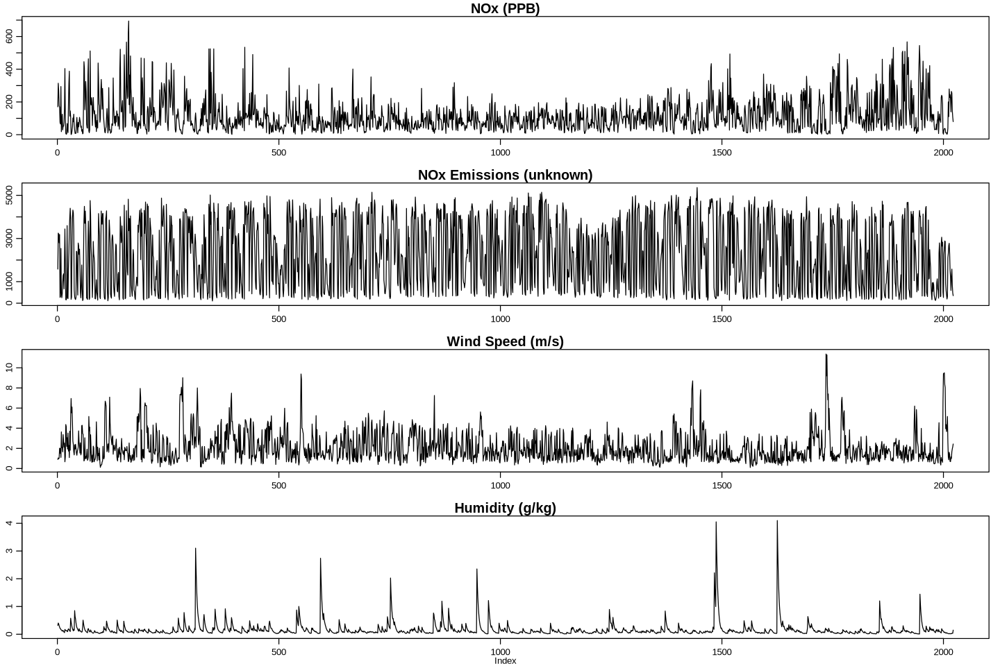

In [118]:
with(options(repr.plot.width = 12, repr.plot.height = 8), {
    par(pin = c(20, 20), mfrow = c(4, 1), mar = c(2.5, 2, 1.5, 1), mgp = c(1.5, 0.7, 0))
    par(cex.lab = 1, cex.axis = 1, cex.main = 1.5, cex.sub = 1.2)
    plot(emissionssw$nox, type = 'l', main = 'NOx (PPB)', xlab = '', ylab = '')
    plot(emissionssw$noxem, type = 'l', main = 'NOx Emissions (unknown)', xlab = '', ylab = '')
    plot(emissionssw$ws, type = 'l', main = 'Wind Speed (m/s)', xlab = '', ylab = '')
    plot(emissionssw$humidity, type = 'l',  main = 'Humidity (g/kg)', xlab = 'Index', ylab = '')
})

In [9]:
cor(emissionssw)

,nox,noxem,ws,humidity
nox,1.00000000,0.51758582,-0.34754186,-0.04739774
noxem,0.51758582,1.00000000,0.11653505,-0.03381921
ws,-0.34754186,0.11653505,1.00000000,0.01722212
humidity,-0.04739774,-0.03381921,0.01722212,1.00000000


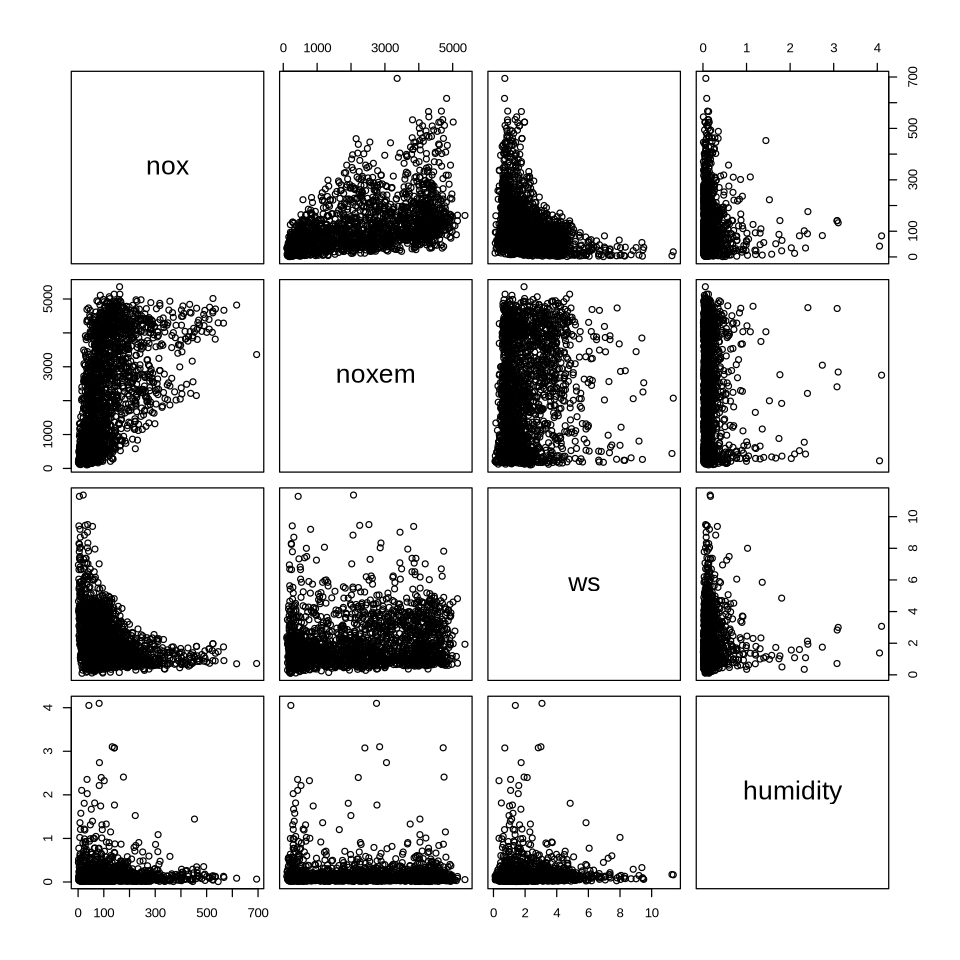

In [98]:
with(options(repr.plot.width = 8, repr.plot.height = 8), {pairs(emissionssw)})

In [12]:
emissionssw.transformed <- data.frame(
    log.nox = log(emissionssw$nox),
    log.noxem = log(emissionssw$noxem),
    ws = emissionssw$ws,
    ws_log.noxem = emissionssw$ws * log(emissionssw$noxem),
    cos = cos(seq(0, 2 * pi, length.out = n))
)

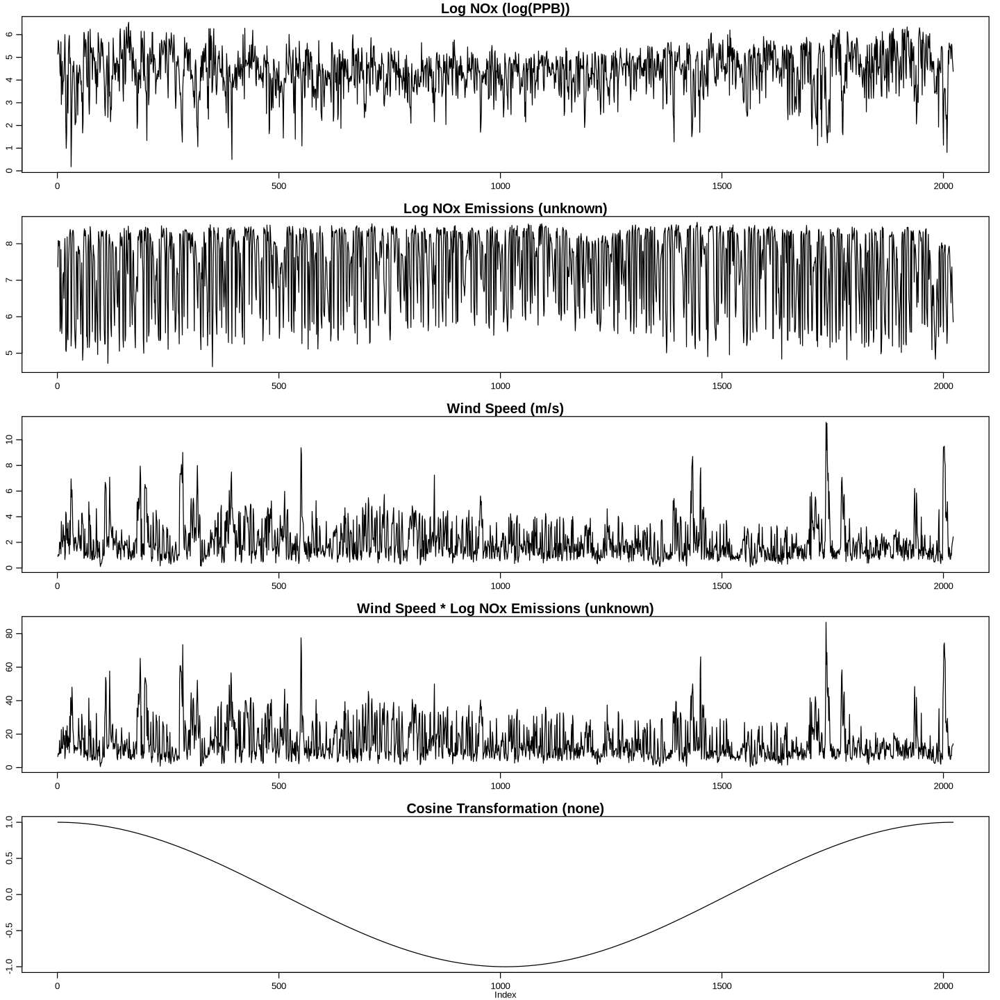

In [100]:
with(options(repr.plot.width = 12, repr.plot.height = 12), {
    par(pin = c(20, 20), mfrow = c(5, 1), mar = c(2.5, 2, 1.5, 1), mgp = c(1.5, 0.7, 0))
    par(cex.lab = 1, cex.axis = 1, cex.main = 1.5, cex.sub = 1.2)
    plot(emissionssw.transformed$log.nox, type = 'l', main = 'Log NOx (log(PPB))', xlab = '', ylab = '')
    plot(emissionssw.transformed$log.noxem, type = 'l', main = 'Log NOx Emissions (unknown)', xlab = '', ylab = '')
    plot(emissionssw.transformed$ws, type = 'l', main = 'Wind Speed (m/s)', xlab = '', ylab = '')
    plot(emissionssw.transformed$ws_log.noxem, type = 'l',  main = 'Wind Speed * Log NOx Emissions (unknown)', xlab = '', ylab = '')
    plot(emissionssw.transformed$cos, type = 'l', main = 'Cosine Transformation (none)', xlab = 'Index', ylab = '')
})

In [35]:
summary(emissionssw.transformed)

    log.nox         log.noxem           ws          ws_log.noxem    
 Min.   :0.1823   Min.   :4.630   Min.   : 0.100   Min.   : 0.5362  
 1st Qu.:3.8649   1st Qu.:6.515   1st Qu.: 1.033   1st Qu.: 7.3668  
 Median :4.4807   Median :7.689   Median : 1.667   Median :11.5093  
 Mean   :4.3844   Mean   :7.337   Mean   : 2.087   Mean   :15.4658  
 3rd Qu.:5.0272   3rd Qu.:8.227   3rd Qu.: 2.750   3rd Qu.:20.9508  
 Max.   :6.5432   Max.   :8.587   Max.   :11.367   Max.   :86.8051  
      cos            
 Min.   :-0.9999988  
 1st Qu.:-0.7068313  
 Median : 0.0007772  
 Mean   : 0.0004946  
 3rd Qu.: 0.7079300  
 Max.   : 1.0000000  

In [13]:
cor(emissionssw.transformed)

,log.nox,log.noxem,ws,ws_log.noxem,cos
log.nox,1.0000000,0.6364005,-0.43374077,-0.28979383,0.11641074
log.noxem,0.6364005,1.0000000,0.10332354,0.28046275,-0.13782892
ws,-0.4337408,0.1033235,1.00000000,0.97513062,0.05175993
ws_log.noxem,-0.2897938,0.2804628,0.97513062,1.00000000,0.01405774
cos,0.1164107,-0.1378289,0.05175993,0.01405774,1.00000000


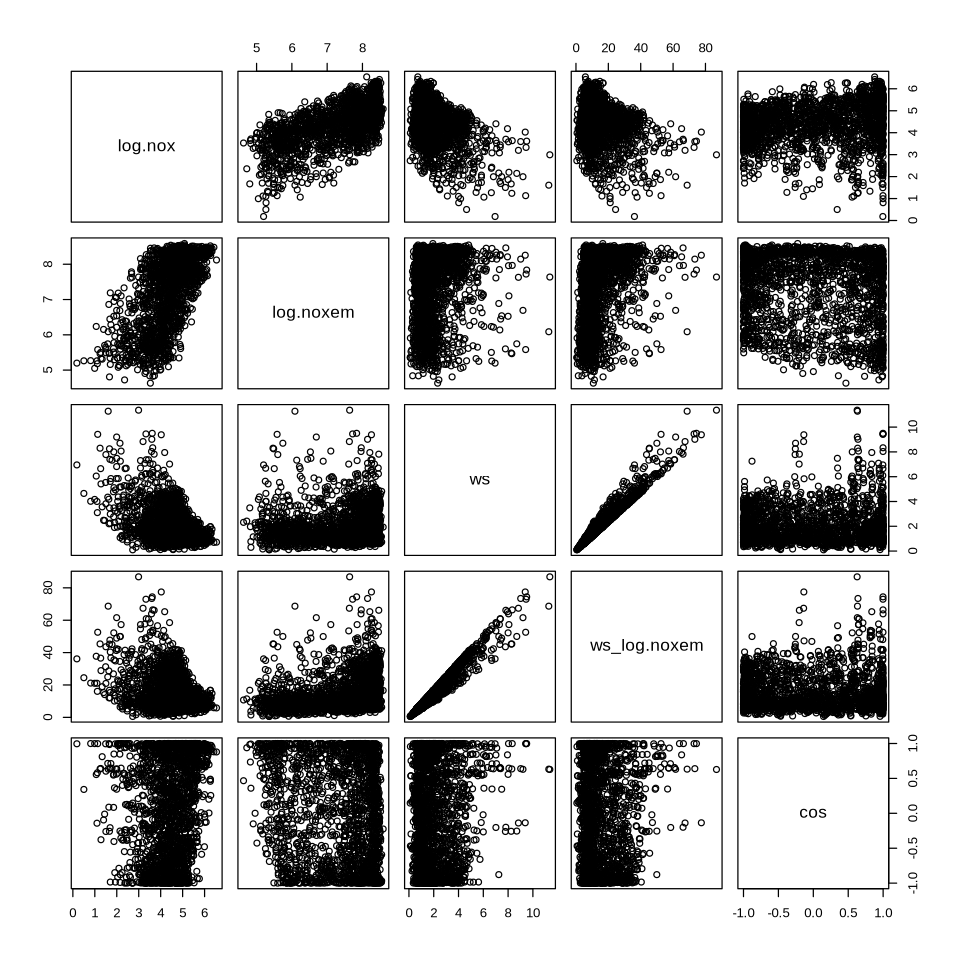

In [99]:
with(options(repr.plot.width = 8, repr.plot.height = 8), {pairs(emissionssw.transformed)})

In [21]:
analyze_model <- function(model){
    print(summary(model))
    par(mfrow = c(2, 2))
    plot(model, which = 1:4, qqline = TRUE, add.smooth = FALSE)
    par(mfrow = c(1, 1))
}

analyze_model_iterative <- function(formula, data, max_iter = 100) {
    model <<- lm(formula, data = data)
    for (i in 1:max_iter) {
        model <- lm(formula, data = data, weights = 1/abs(residuals(model)))
    }
    print(summary(model))
    par(mfrow = c(2, 2))
    plot(model, which = 1:4, qqline = TRUE, add.smooth = FALSE)
    par(mfrow = c(1, 1))
    return(model)
}

loov <- function(formula, data){
    y_preds <- numeric(0)
    for (i in 1:nrow(data)){
        model <- lm(formula, data = data[-i,])
        y_preds[i] <- predict(model, newdata = data[i, ])
    }
    return(data.frame(y_true = data[as.character(formula)[2]], y_preds = y_preds))
}

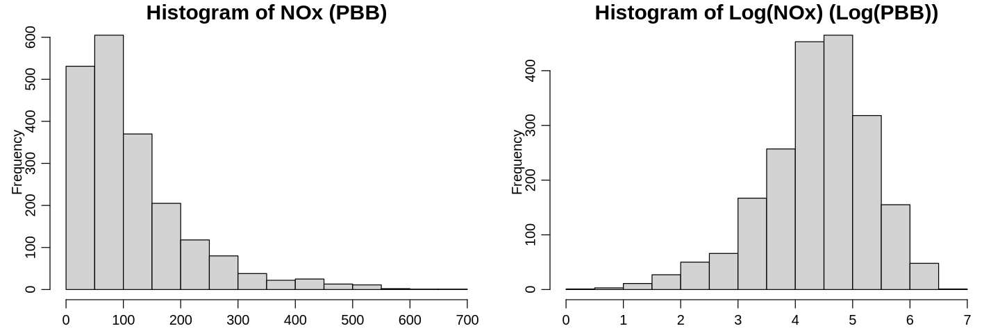

In [120]:
with(options(repr.plot.width = 12, repr.plot.height = 4), {
    par(pin = c(20, 20), mfrow = c(1, 2), mar = c(2, 3, 1.5, 1), mgp = c(1.5, 0.7, 0))
    par(cex.lab = 1, cex.axis = 1, cex.main = 1.5, cex.sub = 1.2)
    hist(emissionssw$nox, main = 'Histogram of NOx (PBB)', xlab = '', ylab = 'Frequency')
    hist(emissionssw.transformed$log.nox, main = 'Histogram of Log(NOx) (Log(PBB))', xlab = '', ylab = 'Frequency')
})


Call:
lm(formula = nox ~ noxem + ws + humidity, data = emissionssw)

Residuals:
    Min      1Q  Median      3Q     Max 
-166.19  -42.65  -15.38   20.03  500.14 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  92.947559   3.699776  25.122   <2e-16 ***
noxem         0.036152   0.001077  33.573   <2e-16 ***
ws          -27.338040   1.113436 -24.553   <2e-16 ***
humidity     -7.227542   5.705300  -1.267    0.205    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 73.89 on 2018 degrees of freedom
Multiple R-squared:  0.437,	Adjusted R-squared:  0.4361 
F-statistic: 522.1 on 3 and 2018 DF,  p-value: < 2.2e-16



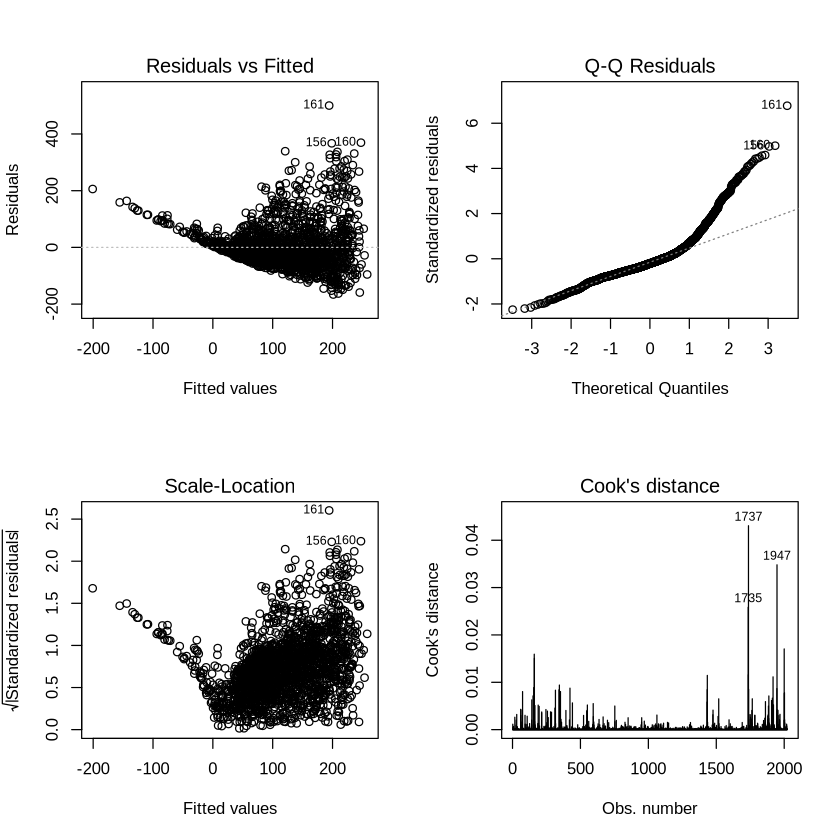

In [24]:
# Baseline linear model with all covariates
baseline_model <- lm(nox ~ noxem + ws + humidity, data=emissionssw)
loov_baseline <- loov(nox ~ noxem + ws + humidity, data=emissionssw)
analyze_model(baseline_model)


Call:
lm(formula = log.nox ~ log.noxem + ws + cos + ws_log.noxem, data = emissionssw.transformed)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.97983 -0.29920  0.04903  0.31879  1.77914 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)   1.013775   0.139058    7.29 4.42e-13 ***
log.noxem     0.553072   0.018978   29.14  < 2e-16 ***
ws           -0.775998   0.056208  -13.81  < 2e-16 ***
cos           0.335390   0.015886   21.11  < 2e-16 ***
ws_log.noxem  0.060279   0.007554    7.98 2.44e-15 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.4976 on 2017 degrees of freedom
Multiple R-squared:  0.7237,	Adjusted R-squared:  0.7231 
F-statistic:  1320 on 4 and 2017 DF,  p-value: < 2.2e-16



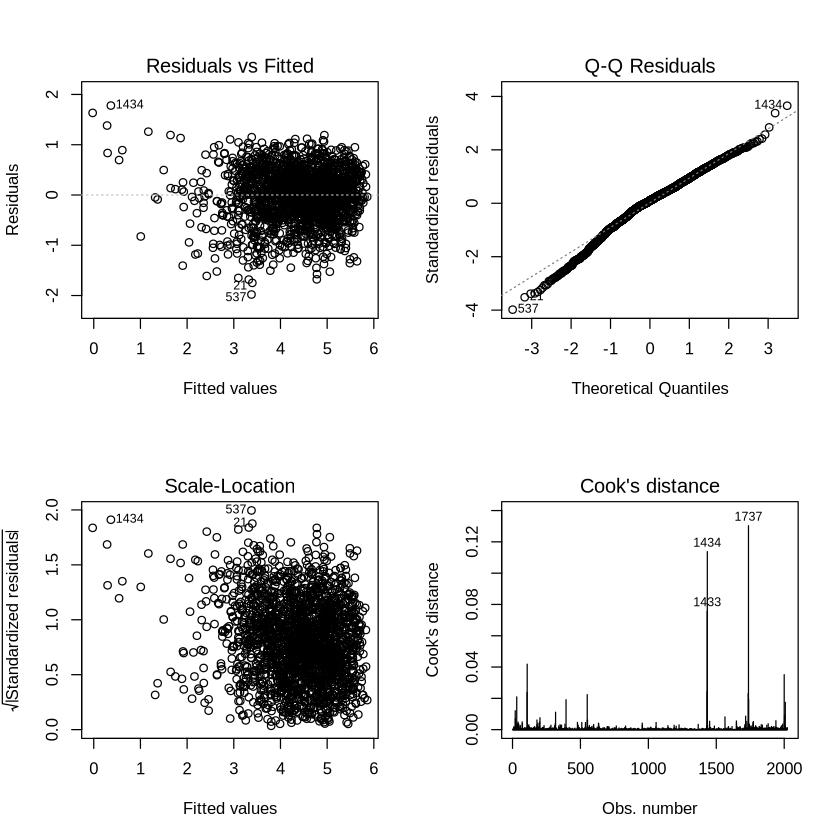

In [25]:
# Transformed model with interactions and time-series features
rejected_model <- lm(log.nox ~ log.noxem + ws + cos + ws_log.noxem, data=emissionssw.transformed)
loov_rejected<- loov(log.nox ~ log.noxem + ws + cos + ws_log.noxem, data=emissionssw.transformed)
analyze_model(rejected_model)


Call:
lm(formula = log.nox ~ log.noxem + ws, data = emissionssw.transformed)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.09712 -0.32843 -0.00142  0.35002  1.43815 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.337195   0.090484   3.727 0.000199 ***
log.noxem    0.643011   0.012234  52.561  < 2e-16 ***
ws          -0.321170   0.008334 -38.540  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.5539 on 2019 degrees of freedom
Multiple R-squared:  0.6572,	Adjusted R-squared:  0.6569 
F-statistic:  1935 on 2 and 2019 DF,  p-value: < 2.2e-16



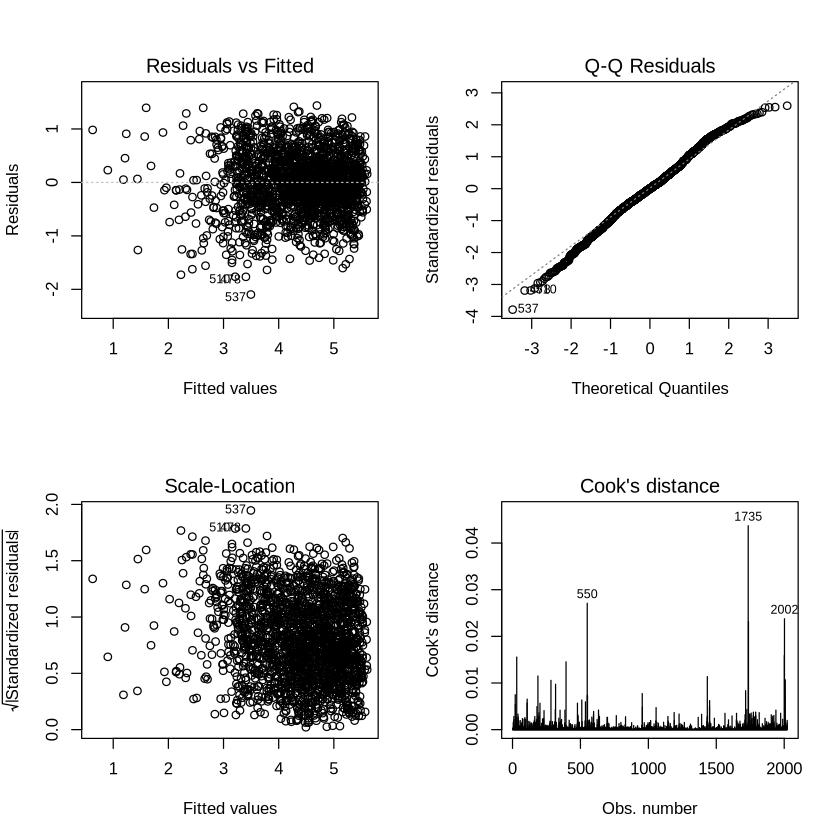

In [26]:
# Recommended simplistic model
recommended.model <- lm(log.nox ~ log.noxem + ws, data=emissionssw.transformed)
loov_rejected <- loov(log.nox ~ log.noxem + ws,  data=emissionssw.transformed)
analyze_model(model)